# **Content**
The dataset contains information on 13,932 single-family homes sold in Miami .

# **Content**
The dataset contains the following columns:

PARCELNO: unique identifier for each property. About 1% appear multiple times.

SALE_PRC: sale price ($)

LND_SQFOOT: land area (square feet)

TOTLVGAREA: floor area (square feet)

SPECFEATVAL: value of special features (e.g., swimming pools) ($)

RAIL_DIST: distance to the nearest rail line (an indicator of noise) (feet)

OCEAN_DIST: distance to the ocean (feet)

WATER_DIST: distance to the nearest body of water (feet)

CNTR_DIST: distance to the Miami central business district (feet)

SUBCNTR_DI: distance to the nearest subcenter (feet)

HWY_DIST: distance to the nearest highway (an indicator of noise) (feet)

age: age of the structure

avno60plus: dummy variable for airplane noise exceeding an acceptable level

structure_quality: quality of the structure

month_sold: sale month in 2016 (1 = jan)

LATITUDE
LONGITUDE

https://www.kaggle.com/deepcontractor/miami-housing-dataset



# Libraries

In [1]:
import folium
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
from folium import plugins
import plotly.express as px
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import folium.plugins as plugins
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import Choropleth, Circle, Marker
from plotly.offline import init_notebook_mode,iplot

# DATA

In [2]:
temp = house_df = pd.read_csv('../input/miami-housing-dataset/miami-housing.csv', encoding = 'ISO-8859-1')
house_df

,LATITUDE,LONGITUDE,PARCELNO,SALE_PRC,LND_SQFOOT,TOT_LVG_AREA,SPEC_FEAT_VAL,RAIL_DIST,OCEAN_DIST,WATER_DIST,CNTR_DIST,SUBCNTR_DI,HWY_DIST,age,avno60plus,month_sold,structure_quality
0,25.891031,-80.160561,622280070620,440000.0,9375,1753,0,2815.9,12811.4,347.6,42815.3,37742.2,15954.9,67,0,8,4
1,25.891324,-80.153968,622280100460,349000.0,9375,1715,0,4359.1,10648.4,337.8,43504.9,37340.5,18125.0,63,0,9,4
2,25.891334,-80.153740,622280100470,800000.0,9375,2276,49206,4412.9,10574.1,297.1,43530.4,37328.7,18200.5,61,0,2,4
3,25.891765,-80.152657,622280100530,988000.0,12450,2058,10033,4585.0,10156.5,0.0,43797.5,37423.2,18514.4,63,0,9,4
4,25.891825,-80.154639,622280100200,755000.0,12800,1684,16681,4063.4,10836.8,326.6,43599.7,37550.8,17903.4,42,0,7,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13927,25.783130,-80.259795,131320040990,275000.0,6780,967,6580,3844.5,20568.0,3252.4,22175.9,12150.1,917.4,16,0,4,4
13928,25.783585,-80.260354,131320040910,340000.0,7500,1854,2544,3593.6,20791.9,3077.7,22375.1,12316.8,738.2,26,0,5,4
13929,25.783793,-80.256126,131320040420,287500.0,8460,1271,2064,4143.2,20307.9,3588.4,20966.9,12433.0,743.7,16,0,7,4
13930,25.784007,-80.257542,131320040330,315000.0,7500,1613,3136,3986.9,20542.6,3589.1,21475.6,12458.0,626.1,16,0,8,4


# EXPLORATION

In [3]:
house_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13932 entries, 0 to 13931
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   LATITUDE           13932 non-null  float64
 1   LONGITUDE          13932 non-null  float64
 2   PARCELNO           13932 non-null  int64  
 3   SALE_PRC           13932 non-null  float64
 4   LND_SQFOOT         13932 non-null  int64  
 5   TOT_LVG_AREA       13932 non-null  int64  
 6   SPEC_FEAT_VAL      13932 non-null  int64  
 7   RAIL_DIST          13932 non-null  float64
 8   OCEAN_DIST         13932 non-null  float64
 9   WATER_DIST         13932 non-null  float64
 10  CNTR_DIST          13932 non-null  float64
 11  SUBCNTR_DI         13932 non-null  float64
 12  HWY_DIST           13932 non-null  float64
 13  age                13932 non-null  int64  
 14  avno60plus         13932 non-null  int64  
 15  month_sold         13932 non-null  int64  
 16  structure_quality  139

In [4]:
house_df.describe()


,LATITUDE,LONGITUDE,PARCELNO,SALE_PRC,LND_SQFOOT,TOT_LVG_AREA,SPEC_FEAT_VAL,RAIL_DIST,OCEAN_DIST,WATER_DIST,CNTR_DIST,SUBCNTR_DI,HWY_DIST,age,avno60plus,month_sold,structure_quality
count,13932.000000,13932.000000,1.393200e+04,1.393200e+04,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000,13932.000000
mean,25.728811,-80.327475,2.356496e+12,3.999419e+05,8620.879917,2058.044574,9562.493468,8348.548715,31690.993798,11960.285235,68490.327132,41115.047265,7723.770693,30.669251,0.014930,6.655828,3.513997
std,0.140633,0.089199,1.199290e+12,3.172147e+05,6070.088742,813.538535,13890.967782,6178.027333,17595.079468,11932.992369,32008.474808,22161.825935,6068.936108,21.153068,0.121276,3.301523,1.097444
min,25.434333,-80.542172,1.020008e+11,7.200000e+04,1248.000000,854.000000,0.000000,10.500000,236.100000,0.000000,3825.600000,1462.800000,90.200000,0.000000,0.000000,1.000000,1.000000
25%,25.620056,-80.403278,1.079160e+12,2.350000e+05,5400.000000,1470.000000,810.000000,3299.450000,18079.350000,2675.850000,42823.100000,23996.250000,2998.125000,14.000000,0.000000,4.000000,2.000000
50%,25.731810,-80.338911,3.040300e+12,3.100000e+05,7500.000000,1877.500000,2765.500000,7106.300000,28541.750000,6922.600000,65852.400000,41109.900000,6159.750000,26.000000,0.000000,7.000000,4.000000
75%,25.852269,-80.258019,3.060170e+12,4.280000e+05,9126.250000,2471.000000,12352.250000,12102.600000,44310.650000,19200.000000,89358.325000,53949.375000,10854.200000,46.000000,0.000000,9.000000,4.000000
max,25.974382,-80.119746,3.660170e+12,2.650000e+06,57064.000000,6287.000000,175020.000000,29621.500000,75744.900000,50399.800000,159976.500000,110553.800000,48167.300000,96.000000,1.000000,12.000000,5.000000


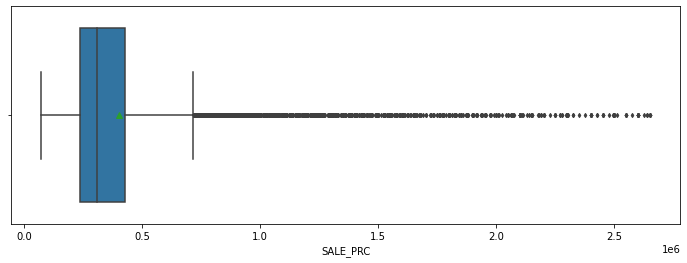

In [5]:
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(x = 'SALE_PRC', data = house_df, orient = 'h', width = 0.8, 
                 fliersize = 3, showmeans=True, ax = ax)
plt.show()

/opt/conda/lib/python3.7/site-packages/seaborn/axisgrid.py:2182: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.



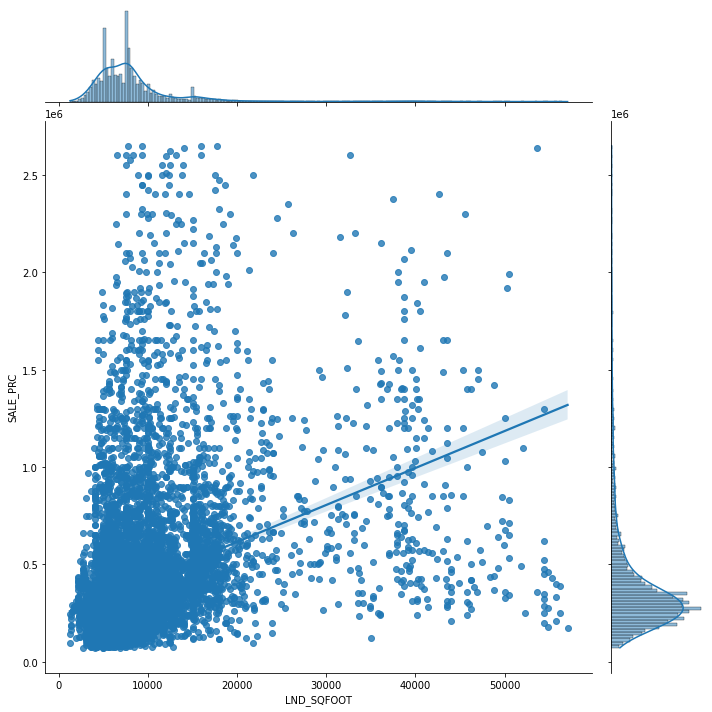

In [6]:
sns.jointplot(x="LND_SQFOOT", y="SALE_PRC", data=house_df, kind = 'reg', size = 10)
plt.show()

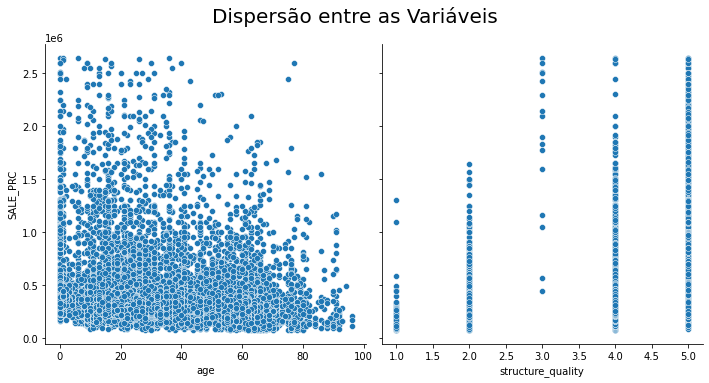

In [7]:
ax = sns.pairplot(house_df, y_vars='SALE_PRC', x_vars=['age', 'structure_quality'], height=5)
ax.fig.suptitle('Dispersão entre as Variáveis', fontsize=20, y=1.05)
ax;

no null data

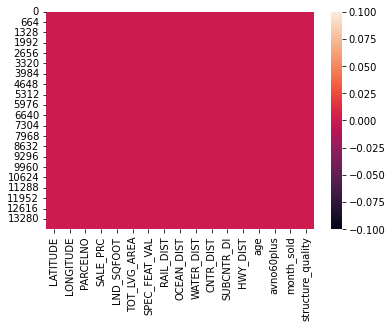

In [8]:
sns.heatmap(house_df.isnull());

# GRAPHICS WITH RAW DATA

In [9]:
fig2 = px.histogram(house_df,x='avno60plus',color='avno60plus',template='plotly_dark')
fig2.show()

In [10]:
fig2 = px.histogram(house_df,x='structure_quality',color='structure_quality',template='plotly_dark')
fig2.show()

In [11]:
fig2 = px.histogram(house_df,x='month_sold',color='month_sold',template='plotly_dark')
fig2.show()

In [12]:
fig2 = px.histogram(house_df,x='age',color='age',template='plotly_dark')
fig2.show()

In [13]:
fig2 = px.histogram(house_df,x='SALE_PRC',color='SALE_PRC',template='plotly_dark')
fig2.show()

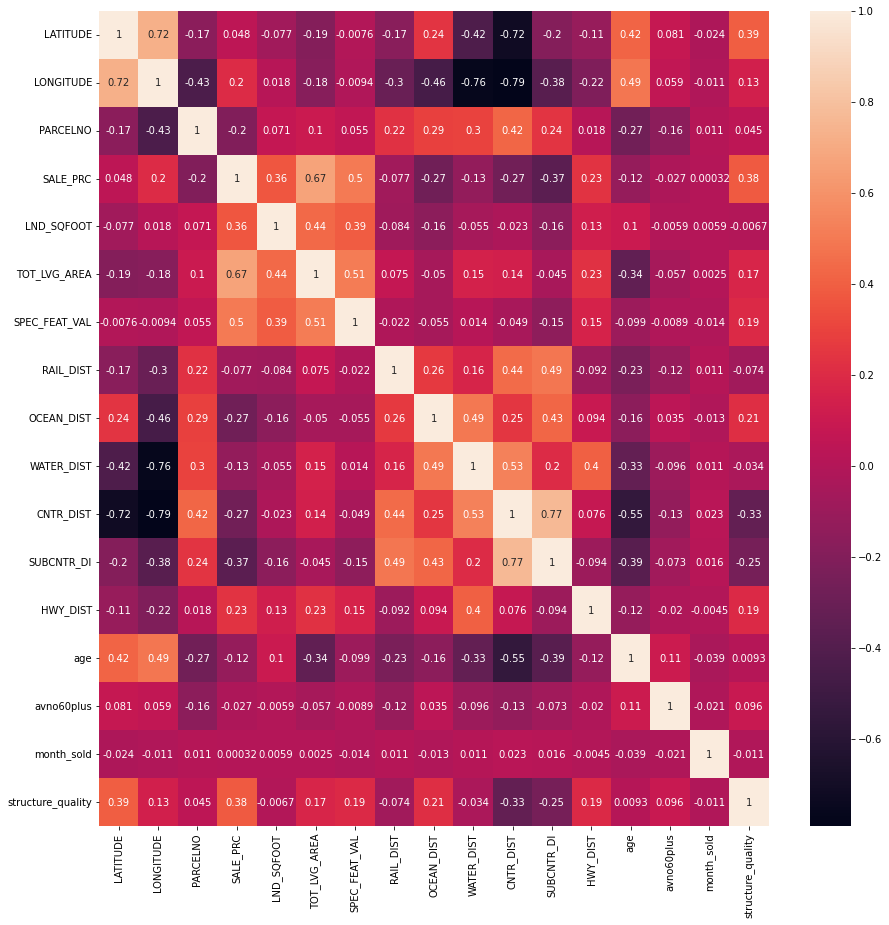

In [14]:
f, ax = plt.subplots(figsize = (15, 15))
sns.heatmap(house_df.corr(), annot = True);

# SUMMARY OF GRAPHICS

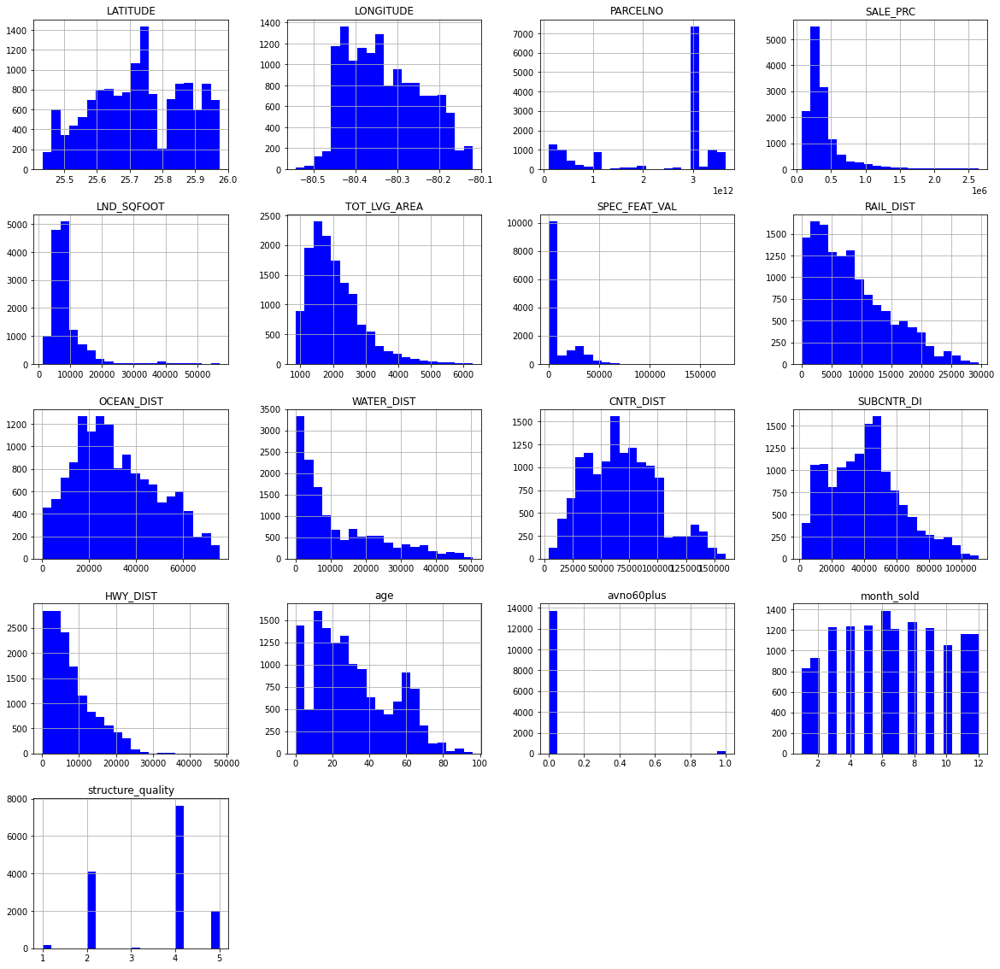

In [15]:
house_df.hist(bins = 20, figsize = (20,20), color = 'b');

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



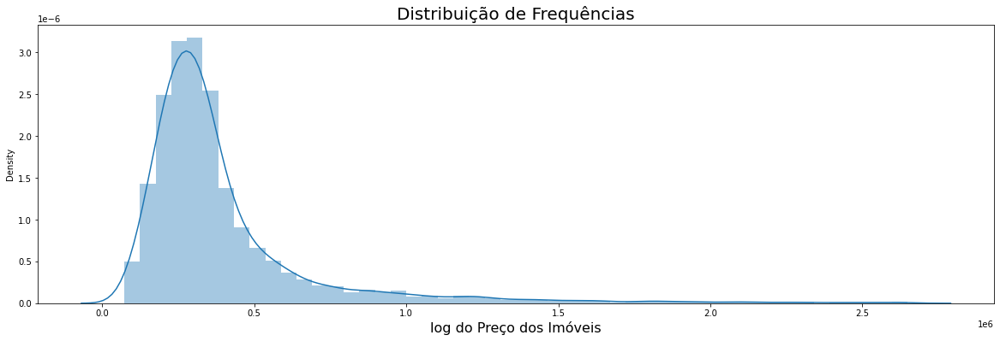

In [16]:
ax = sns.distplot(house_df['SALE_PRC'])
ax.figure.set_size_inches(20,6)
ax.set_title('Distribuição de Frequências', fontsize=20)
ax.set_xlabel('log do Preço dos Imóveis', fontsize=16)
ax;

# Maps

**Heat map, where most properties are found.**

In [17]:
map_1 = folium.Map(location=[25.7751, -80.2105], tiles='cartodbpositron', zoom_start=10)
HeatMap(data=house_df[['LATITUDE', 'LONGITUDE']], radius=10).add_to(map_1)
map_1

 **Cluster map, if we get closer and closer it will open up until we can see the location of the property, clicking on the location will be possible to see the value of each property.**

In [18]:
f = folium.Figure(width=1200, height=750)
miami_map = folium.Map(location = [house_df['LATITUDE'].mean(), 
                                  house_df['LONGITUDE'].mean()], 
                      zoom_start = 10).add_to(f)
price=folium.map.FeatureGroup()
price=plugins.MarkerCluster().add_to(miami_map)
for lat,lon,label in zip(house_df.LATITUDE,house_df.LONGITUDE,house_df.SALE_PRC):
    folium.Marker(location=[lat,lon],icon=None,popup=label).add_to(price)
miami_map.add_child(price)
miami_map

**A detail that caught my attention is that on the edge of Miami Beach there are no properties for sale.
Before the start of the pandemic I had the opportunity to stay for 10 days on Collins Avenue, close to 7th Street, I noticed many empty properties nearby and also closed.
I wonder why you don't have properties for sale in that region when there are so many empty and closed properties.**

In this map below I put it in dark just for visual effect, but approaching and leaning on the buildings you can see the age of each one of them.

In [19]:
f = folium.Figure(width=1200, height=750)
miami_map = folium.Map(location = [house_df['LATITUDE'].mean(), 
                                  house_df['LONGITUDE'].mean()], 
                      zoom_start = 10,  tiles='CartoDB dark_matter').add_to(f)
price=folium.map.FeatureGroup()
price=plugins.MarkerCluster().add_to(miami_map)
for lat,lon,label in zip(house_df.LATITUDE,house_df.LONGITUDE,house_df.age):
    folium.Marker(location=[lat,lon],icon=None,popup=label).add_to(price)
miami_map.add_child(price)
miami_map

# Initial Processing

In [20]:
selected_features = ['SALE_PRC', 'LND_SQFOOT', 'TOT_LVG_AREA', 'SPEC_FEAT_VAL', 'RAIL_DIST', 'OCEAN_DIST', 'WATER_DIST', 'CNTR_DIST', 'SUBCNTR_DI', 'HWY_DIST', 'age', 'avno60plus', 'month_sold', 'structure_quality']
X = house_df[selected_features]
X

,SALE_PRC,LND_SQFOOT,TOT_LVG_AREA,SPEC_FEAT_VAL,RAIL_DIST,OCEAN_DIST,WATER_DIST,CNTR_DIST,SUBCNTR_DI,HWY_DIST,age,avno60plus,month_sold,structure_quality
0,440000.0,9375,1753,0,2815.9,12811.4,347.6,42815.3,37742.2,15954.9,67,0,8,4
1,349000.0,9375,1715,0,4359.1,10648.4,337.8,43504.9,37340.5,18125.0,63,0,9,4
2,800000.0,9375,2276,49206,4412.9,10574.1,297.1,43530.4,37328.7,18200.5,61,0,2,4
3,988000.0,12450,2058,10033,4585.0,10156.5,0.0,43797.5,37423.2,18514.4,63,0,9,4
4,755000.0,12800,1684,16681,4063.4,10836.8,326.6,43599.7,37550.8,17903.4,42,0,7,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13927,275000.0,6780,967,6580,3844.5,20568.0,3252.4,22175.9,12150.1,917.4,16,0,4,4
13928,340000.0,7500,1854,2544,3593.6,20791.9,3077.7,22375.1,12316.8,738.2,26,0,5,4
13929,287500.0,8460,1271,2064,4143.2,20307.9,3588.4,20966.9,12433.0,743.7,16,0,7,4
13930,315000.0,7500,1613,3136,3986.9,20542.6,3589.1,21475.6,12458.0,626.1,16,0,8,4


In [21]:
y = house_df['SALE_PRC']
y.head()

0    440000.0
1    349000.0
2    800000.0
3    988000.0
4    755000.0
Name: SALE_PRC, dtype: float64

In [22]:
print(X.shape, y.shape)

(13932, 14) (13932,)


In [23]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

In [24]:
X_scaled

array([[0.14274631, 0.14560341, 0.16547027, ..., 0.        , 0.63636364,
        0.75      ],
       [0.10744763, 0.14560341, 0.15847598, ..., 0.        , 0.72727273,
        0.75      ],
       [0.28238945, 0.14560341, 0.26173385, ..., 0.        , 0.09090909,
        0.75      ],
       ...,
       [0.08359193, 0.12921026, 0.07675318, ..., 0.        , 0.54545455,
        0.75      ],
       [0.09425912, 0.11201089, 0.13970182, ..., 0.        , 0.63636364,
        0.75      ],
       [0.06904577, 0.13589293, 0.18645316, ..., 0.        , 0.90909091,
        0.75      ]])

In [25]:
X_scaled.shape

(13932, 14)

In [26]:
y = y.values.reshape(-1,1)

In [27]:
y.shape

(13932, 1)

In [28]:
y_scaled = scaler.fit_transform(y)

In [29]:
y_scaled

array([[0.14274631],
       [0.10744763],
       [0.28238945],
       ...,
       [0.08359193],
       [0.09425912],
       [0.06904577]])

# Training

In [30]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size = 0.25)

In [31]:
print(X_train.shape, X_test.shape )

(10449, 14) (3483, 14)


In [32]:
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(units=100, activation='relu', input_shape=(14, )))
model.add(tf.keras.layers.Dense(units=100, activation='relu'))
model.add(tf.keras.layers.Dense(units=100, activation='relu'))
model.add(tf.keras.layers.Dense(units=1, activation='linear')) 


User settings:

   KMP_AFFINITY=granularity=fine,verbose,compact,1,0
   KMP_BLOCKTIME=0
   KMP_DUPLICATE_LIB_OK=True
   KMP_INIT_AT_FORK=FALSE
   KMP_SETTINGS=1
   KMP_WARNINGS=0

Effective settings:

   KMP_ABORT_DELAY=0
   KMP_ADAPTIVE_LOCK_PROPS='1,1024'
   KMP_ALIGN_ALLOC=64
   KMP_ALL_THREADPRIVATE=128
   KMP_ATOMIC_MODE=2
   KMP_BLOCKTIME=0
   KMP_CPUINFO_FILE: value is not defined
   KMP_DETERMINISTIC_REDUCTION=false
   KMP_DEVICE_THREAD_LIMIT=2147483647
   KMP_DISP_NUM_BUFFERS=7
   KMP_DUPLICATE_LIB_OK=true
   KMP_ENABLE_TASK_THROTTLING=true
   KMP_FORCE_REDUCTION: value is not defined
   KMP_FOREIGN_THREADS_THREADPRIVATE=true
   KMP_FORKJOIN_BARRIER='2,2'
   KMP_FORKJOIN_BARRIER_PATTERN='hyper,hyper'
   KMP_GTID_MODE=3
   KMP_HANDLE_SIGNALS=false
   KMP_HOT_TEAMS_MAX_LEVEL=1
   KMP_HOT_TEAMS_MODE=0
   KMP_INIT_AT_FORK=true
   KMP_LIBRARY=throughput
   KMP_LOCK_KIND=queuing
   KMP_MALLOC_POOL_INCR=1M
   KMP_NUM_LOCKS_IN_BLOCK=1
   KMP_PLAIN_BARRIER='2,2'
   KMP_PLAIN_BARRIER_P

In [33]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 100)               1500      
_________________________________________________________________
dense_1 (Dense)              (None, 100)               10100     
_________________________________________________________________
dense_2 (Dense)              (None, 100)               10100     
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 101       
Total params: 21,801
Trainable params: 21,801
Non-trainable params: 0
_________________________________________________________________


In [34]:
model.compile(optimizer='Adam', loss='mean_squared_error')

In [35]:
epochs_hist = model.fit(X_train, y_train, epochs = 10, batch_size = 50, validation_split = 0.2)

2021-11-12 14:29:20.211906: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/10
168/168 [==============================] - 1s 4ms/step - loss: 0.0017 - val_loss: 1.6123e-04
Epoch 2/10
168/168 [==============================] - 1s 3ms/step - loss: 1.2639e-04 - val_loss: 1.0442e-04
Epoch 3/10
168/168 [==============================] - 1s 3ms/step - loss: 6.8957e-05 - val_loss: 6.1125e-05
Epoch 4/10
168/168 [==============================] - 1s 3ms/step - loss: 4.1400e-05 - val_loss: 6.4277e-05
Epoch 5/10
168/168 [==============================] - 1s 3ms/step - loss: 4.7287e-05 - val_loss: 7.6049e-05
Epoch 6/10
168/168 [==============================] - 1s 3ms/step - loss: 2.7407e-05 - val_loss: 3.0400e-05
Epoch 7/10
168/168 [==============================] - 1s 3ms/step - loss: 3.1559e-05 - val_loss: 3.9114e-05
Epoch 8/10
168/168 [==============================] - 1s 3ms/step - loss: 2.3062e-05 - val_loss: 1.8430e-05
Epoch 9/10
168/168 [==============================] - 1s 3ms/step - loss: 2.6372e-05 - val_loss: 2.4808e-05
Epoch 10/10
168/168 [===========

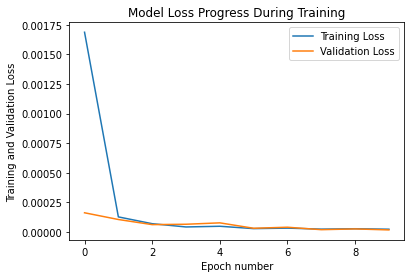

In [36]:
plt.plot(epochs_hist.history['loss'])
plt.plot(epochs_hist.history['val_loss'])
plt.title('Model Loss Progress During Training')
plt.ylabel('Training and Validation Loss')
plt.xlabel('Epoch number')
plt.legend(['Training Loss', 'Validation Loss']);

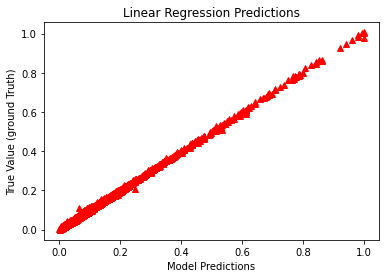

In [37]:
y_predict = model.predict(X_test)
plt.plot(y_test, y_predict, "^", color = 'r')
plt.xlabel("Model Predictions")
plt.ylabel("True Value (ground Truth)")
plt.title('Linear Regression Predictions')
plt.show()

In [38]:
y_predict_orig = scaler.inverse_transform(y_predict)
y_test_orig = scaler.inverse_transform(y_test)

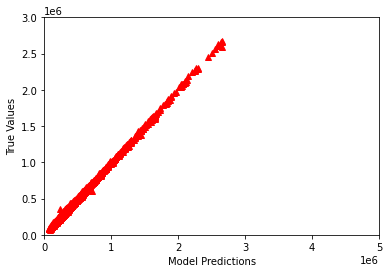

In [39]:
plt.plot(y_test_orig, y_predict_orig, "^", color = 'r')
plt.xlabel('Model Predictions')
plt.ylabel('True Values')
plt.xlim(0, 5000000)
plt.ylim(0, 3000000);

In [40]:
k = X_test.shape[1]
n = len(X_test)
n

3483

In [41]:
k

14

In [42]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from math import sqrt

RMSE = float(format(np.sqrt(mean_squared_error(y_test_orig, y_predict_orig)),'.3f'))
MSE = mean_squared_error(y_test_orig, y_predict_orig)
MAE = mean_absolute_error(y_test_orig, y_predict_orig)
r2 = r2_score(y_test_orig, y_predict_orig)
adj_r2 = 1-(1-r2)*(n-1)/(n-k-1)

print('RMSE =',RMSE, '\nMSE =',MSE, '\nMAE =',MAE, '\nR2 =', r2, '\nAdjusted R2 =', adj_r2) 

RMSE = 10184.458 
MSE = 103723183.83951037 
MAE = 7300.1285148399365 
R2 = 0.998927242341044 
Adjusted R2 = 0.9989229117161232


# Conclusion

**By the analysis of the Adjusted R2, all the added features were useful for the analysis of the algorithm;**